In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import solve_ivp

# Gravitational three orbits

The Lagrangian of system is:
\begin{align}
\mathcal{L}&= \frac{1}{2}m_1(\dot{x_1}^2+\dot{y_1}^2) + \frac{1}{2}m_2(\dot{x_2}^2+\dot{y_2}^2) + \frac{1}{2}m_3(\dot{x_3}^2+\dot{y_3}^2) \\
& - \frac{G m_1 m_2}{r_{12}} - \frac{G m_1 m_3}{r_{13}} - \frac{G m_2 m_3}{r_{23}}
\end{align}

where
$$r_{12}=((x_1-x_2)^2+(y_1-y_2)^2)^{\frac{1}{2}}$$
$$r_{13}=((x_1-x_3)^2+(y_1-y_3)^2)^{\frac{1}{2}}$$
$$r_{23}=((x_2-x_3)^2+(y_2-y_3)^2)^{\frac{1}{2}}$$

Solve for Lagrange's equation:
\begin{align}
\ddot x_1 = -\frac{Gm_2(x_1-x_2)}{r_{12}^3} - \frac{Gm_3(x_1-x_3)}{r_{13}^3} \\
\ddot y_1 = -\frac{Gm_2(y_1-y_2)}{r_{12}^3} - \frac{Gm_3(y_1-y_3)}{r_{13}^3} \\
\ddot x_2= \frac{Gm_1(x_1-x_2)}{r_{12}^3} - \frac{Gm_3(x_2-x_3)}{r_{23}^3} \\
\ddot y_2= \frac{Gm_1(y_1-y_2)}{r_{12}^3} - \frac{Gm_3(y_2-y_3)}{r_{23}^3} \\
\ddot x_3= \frac{Gm_1(x_1-x_3)}{r_{13}^3} + \frac{Gm_2(x_2-x_3)}{r_{23}^3} \\
\ddot y_3= \frac{Gm_1(y_1-y_3)}{r_{13}^3} + \frac{Gm_2(y_2-y_3)}{r_{23}^3} \\
\end{align}

In [2]:
# The dpi (dots-per-inch) setting will affect the resolution and how large
#  the plots appear on screen and printed.  So you may want/need to adjust 
#  the figsize when creating the figure.
plt.rcParams['figure.dpi'] = 100.    # this is the default for notebook

# Change the common font size (smaller when higher dpi)
font_size = 14
plt.rcParams.update({'font.size': font_size})

In [3]:
class GravitationalOrbits():
    """
    This class implements the parameters and Lagrange's equations for
    two particles orbiting under gravitational attraction.
    
    Parameters
    ----------
    m_1 : float
    m_2 : float
    m_3 : float
    G : float
    
    Methods
    -------
    dz_dt(t, z)
        Returns the right side of the differential equation in vector z,
        given time t and the corresponding value of z.
    """
    
    def __init__(self, m_1=1., m_2=1., m_3=1., G=1):
        self.m_1 = m_1
        self.m_2 = m_2
        self.m_3 = m_3
        self.G = G
    
    def dz_dt(self, t, z):
        """
        This function returns the right-hand side of the diffeq: 
        [dz/dt d^2z/dt^2]
        
        Parameters
        ----------
        t : float
            time 
        z : float
            A 12-component vector with 
            z[0] = x_1(t) and z[1] = x_dot_1(t)
            z[2] = y_1(t) and z[3] = y_dot_1(t)
            z[4] = x_2(t) and z[5] = x_dot_2(t)
            z[6] = y_2(t) and z[7] = y_dot_2(t)
            z[8] = x_3(t) and z[9] = x_dot_3(t)
            z[10] = y_3(t) and z[11] = y_dot_3(t)
            
        Returns
        -------
        
        """
        r_12 = np.sqrt( (z[0] - z[4])**2 + (z[2] - z[6])**2 )
        r_23 = np.sqrt( (z[8] - z[4])**2 + (z[10] - z[6])**2 )
        r_13 = np.sqrt( (z[0] - z[8])**2 + (z[2] - z[10])**2 )
        return [  
                z[1], self.G * self.m_2 * (z[4] - z[0]) / r_12**3 + self.G * self.m_3 * (z[8] - z[0]) / r_13**3, \
                z[3], self.G * self.m_2 * (z[6] - z[2]) / r_12**3 + self.G * self.m_3 * (z[10] - z[2]) / r_13**3, \
                z[5], -self.G * self.m_1 * (z[4] - z[0]) / r_12**3 + self.G * self.m_3 * (z[8] - z[4]) / r_23**3, \
                z[7], -self.G * self.m_1 * (z[6] - z[2]) / r_12**3 + self.G * self.m_3 * (z[10] - z[6]) / r_23**3, \
                z[9], -self.G * self.m_1 * (z[8] - z[0]) / r_13**3 - self.G * self.m_2 * (z[8] - z[4]) / r_23**3, \
                z[11], -self.G * self.m_1 * (z[10] - z[2]) / r_13**3 - self.G * self.m_2 * (z[10] - z[6]) / r_23**3, \
               ]
    
    
    def solve_ode(self, t_pts, z_0,
                  abserr=1.0e-8, relerr=1.0e-8):
        """
        Solve the ODE given initial conditions.
        Specify smaller abserr and relerr to get more precision.
        """
        solution = solve_ivp(self.dz_dt, (t_pts[0], t_pts[-1]), 
                             z_0, t_eval=t_pts, method='RK23',
                             atol=abserr, rtol=relerr)
        x_1, x_dot_1, y_1, y_dot_1, x_2, x_dot_2, y_2, y_dot_2, x_3, x_dot_3, y_3, y_dot_3 = solution.y
        
        return x_1, x_dot_1, y_1, y_dot_1, x_2, x_dot_2, y_2, y_dot_2, x_3, x_dot_3, y_3, y_dot_3

In [4]:
def plot_y_vs_x(x, y, axis_labels=None, label=None, title=None, 
                color=None, linestyle=None, semilogy=False, loglog=False,
                ax=None):
    """
    Generic plotting function: return a figure axis with a plot of y vs. x,
    with line color and style, title, axis labels, and line label
    """
    if ax is None:        # if the axis object doesn't exist, make one
        ax = plt.gca()

    if (semilogy):
        line, = ax.semilogy(x, y, label=label, 
                            color=color, linestyle=linestyle)
    elif (loglog):
        line, = ax.loglog(x, y, label=label, 
                          color=color, linestyle=linestyle)
    else:
        line, = ax.plot(x, y, label=label, 
                    color=color, linestyle=linestyle)

    if label is not None:    # if a label if passed, show the legend
        ax.legend()
    if title is not None:    # set a title if one if passed
        ax.set_title(title)
    if axis_labels is not None:  # set x-axis and y-axis labels if passed  
        ax.set_xlabel(axis_labels[0])
        ax.set_ylabel(axis_labels[1])

    return ax, line

In [5]:
def start_stop_indices(t_pts, plot_start, plot_stop):
    start_index = (np.fabs(t_pts-plot_start)).argmin()  # index in t_pts array 
    stop_index = (np.fabs(t_pts-plot_stop)).argmin()  # index in t_pts array 
    return start_index, stop_index

In [6]:
# Labels for individual plot axes
orbit_labels = (r'$x$', r'$y$')

#Common plotting time (generate the full time then use slices)
t_start = 0.
t_end = 100.
delta_t = 0.01

t_pts = np.arange(t_start, t_end+delta_t, delta_t)  

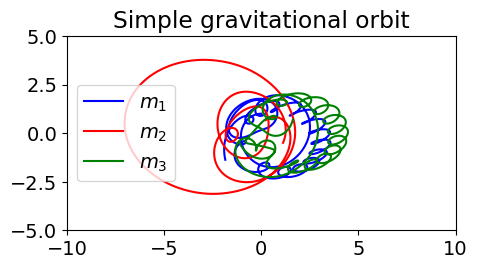

In [15]:
G = 1.
m_1 = 1.
m_2 = 1.
m_3 = 1.

#Instantiate a set of orbits
o1 = GravitationalOrbits(m_1, m_2, m_3, G)

# initial conditions with com velocity zero
x_1_0, x_dot_1_0 = 0., -1./1.5
y_1_0, y_dot_1_0 = 1., 0
x_2_0, x_dot_2_0 = np.sqrt(5)/2., 1./3.
y_2_0, y_dot_2_0 = -1./2.,np.sqrt(5)/3.
x_3_0, x_dot_3_0 = -(m_1 / m_3) * x_1_0 -(m_2 / m_3) * x_2_0 , -(m_1 / m_3) * x_dot_1_0 -(m_2 / m_3) * x_dot_2_0
y_3_0, y_dot_3_0 = -(m_1 / m_3) * y_1_0 -(m_2 / m_3) * y_2_0 , -(m_1 / m_3) * y_dot_1_0 -(m_2 / m_3) * y_dot_2_0

z_0 = [x_1_0, x_dot_1_0, y_1_0, y_dot_1_0, \
       x_2_0, x_dot_2_0, y_2_0, y_dot_2_0, \
       x_3_0, x_dot_3_0, y_3_0, y_dot_3_0]
x_1, x_dot_1, y_1, y_dot_1, x_2, x_dot_2, y_2, y_dot_2, x_3, x_dot_3, y_3, y_dot_3 = \
           o1.solve_ode(t_pts, z_0)

#start the plot!
fig = plt.figure(figsize=(5,5))

#first plot: orbit
ax = fig.add_subplot(1, 1, 1)

start, stop = start_stop_indices(t_pts, t_start, t_end)    
ax.plot(x_1, y_1, color='blue', label=r'$m_1$')
ax.plot(x_2, y_2, color='red', label=r'$m_2$')
ax.plot(x_3, y_3, color='green', label=r'$m_3$')
ax.set_title('Simple gravitational orbit')
ax.legend(loc='center left')
ax.set_aspect(1)

ax.set_xlim(-10, 10)
ax.set_ylim(-5, 5)


fig.tight_layout()
fig.savefig('simple_orbits.png', bbox_inches='tight')

In [8]:
from matplotlib import animation, rc
from IPython.display import HTML

In [9]:
%%capture
x_min = -5
x_max = 5
y_min = -5
y_max = 5

fig_anim = plt.figure(figsize=(5, 3), num='Double Orbit')
ax_anim = fig_anim.add_subplot(1,1,1)
ax_anim.set_xlim(x_min, x_max)
ax_anim.set_ylim(y_min, y_max)

# By assigning the first return from plot to pt1_anim and the others,
# we can later change the values.
ln1_anim, = ax_anim.plot(x_1, y_1, color='blue', lw=1)
ln2_anim, = ax_anim.plot(x_2, y_2, color='red', lw=1)
ln3_anim, = ax_anim.plot(x_3, y_3, color='green', lw=1)

pt1_anim, = ax_anim.plot(x_1[0], y_1[0], 'o', markersize=8, color='blue')
pt2_anim, = ax_anim.plot(x_2[0], y_2[0], 'o', markersize=8, color='red')
pt3_anim, = ax_anim.plot(x_3[0], y_3[0], 'o', markersize=8, color='green')

ax_anim.set_aspect(1)
ax_anim.axis('off')
fig_anim.tight_layout()

In [10]:
def animate_orbits(i):
    """
    This is the function called by FuncAnimation to create each frame,
    numbered by i. So each i corresponds to a point in the t_pts
    array, with index i.
    """
    
    i_skip = 1 * i
    
    pt1_anim.set_data(x_1[i_skip], y_1[i_skip])
    pt2_anim.set_data(x_2[i_skip], y_2[i_skip])
    pt3_anim.set_data(x_3[i_skip], y_3[i_skip])
    
    return (pt1_anim, pt2_anim, pt3_anim) # this is needed for blit=True

In [13]:
frame_interval = 10. # time between frames
frame_number = 1001 # number of frames to include (index of t_pts)
anim =animation.FuncAnimation(fig_anim,
                              animate_orbits,
                              init_func=None,
                              frames=frame_number,
                              interval=frame_interval,
                              blit=True,
                              repeat=False)

In [14]:
HTML(anim.to_jshtml()) #animate

Animation size has reached 20989633 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Blue and grenn can sometimes form a relatively stable two-body system. The three planets interact and capture each other. The orbit cannot be predicted for a long time, and this three-body system is chaotic.